In [1]:
from CAESAR.compressor import CAESAR

In [2]:
def domain_arg(test_set = "S3D"):
    
    if test_set == "E3SM":

        data_arg = {"data_path":"/blue/ranka/shared-xiaoli/ScientificDataset/E3SM/e3sm_1.npz",
                    "variable_idx": [0],
                    "section_range": [0,6],
                    "frame_range": [0,720],
                    "n_frame":16,
                    "n_overlap":0,
                    "train": False,
                    "train_size":256,
                    "test_size":(256,256),
                    "inst_norm": True, "norm_type":'mean_range'}

        valid_length = 720

    elif  test_set == "S3D":
        
        data_arg = {"data_path":"/blue/ranka/shared-xiaoli/ScientificDataset/S3D/s3d.npz",
                    "variable_idx": [8],
                    "section_range": [0,1],
                    "frame_range": [0,48],
                    "n_frame":16,
                    "train": False,}

        valid_length = 48


    elif test_set == "JHTDB":

        data_arg = {"data_path":"/blue/ranka/shared-xiaoli/ScientificDataset/JHTDB/JHTDB.npz",
                    "variable_idx": [0],
                    "section_range": [48, 56],
                    "frame_range": [0,120],
                    "n_frame":16,
                    "train": False,}

        valid_length = 120
        
    return data_arg, valid_length

In [3]:
data_arg = {"data_path":"/blue/ranka/shared-xiaoli/ScientificDataset/S3D/s3d.npz",
            "variable_idx": [8],
            "section_range": [0,1],
            "frame_range": [0,48],
            "resolution": (512,512),
            "n_frame":16,
            "train": False,}



In [4]:
compressor = CAESAR(model_path="../GenCompress/snapshots/caesar_model/caesar_v.pt", use_diffusion = False, device = "cuda")


/home/xiao.li/.local/lib/python3.12/site-packages/compressai/models/video/google.py:353: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @amp.autocast(enabled=False)


Loading CAESAE-V


In [5]:
from dataset import ScientificDataset
from torch.utils.data import DataLoader

dataset_org = ScientificDataset(data_arg)
shape = dataset_org.data_input.shape

dataloader =  DataLoader(dataset_org, batch_size=64, shuffle=False, num_workers=2)



*************** Loading Customized Dataset ***************
Testing Data Shape torch.Size([1, 4, 48, 256, 256])


In [6]:
data_arg

{'data_path': '/blue/ranka/shared-xiaoli/ScientificDataset/S3D/s3d.npz',
 'variable_idx': [8],
 'section_range': [0, 1],
 'frame_range': [0, 48],
 'resolution': (512, 512),
 'n_frame': 16,
 'train': False}

In [7]:
import torch

In [8]:
torch.randn(12,3).cuda()

tensor([[ 0.1465,  0.4534,  0.5283],
        [ 0.3929, -0.3510,  0.2946],
        [-0.6708,  0.5885, -0.0976],
        [ 0.1380,  0.4359,  0.7936],
        [ 0.7900,  0.5749, -1.0900],
        [ 0.4378, -1.9570,  0.9137],
        [-0.4302,  0.8397,  1.3248],
        [ 0.3285, -1.0114, -0.0121],
        [ 0.6728,  1.2223, -0.6207],
        [ 1.0190, -0.4486, -1.4739],
        [ 0.5564,  0.9148,  0.7779],
        [ 0.6367, -0.4492, -0.8511]], device='cuda:0')

In [18]:
compressed_data, compressed_size = compressor.compress(dataloader, eb=800e-4)

recons_data = compressor.decompress(compressed_data)

<nvidia.nvcomp.nvcomp_impl.Array object at 0x14a43cfda470> |u1
<nvidia.nvcomp.nvcomp_impl.Array object at 0x14a1d755d830> |u1


In [19]:
# valid_length = 46
import numpy as np

original_data = dataset_org.original_data()

axis = (0, 1, 2, 3, 4)
nrmse = torch.sqrt(torch.mean((original_data - recons_data) ** 2, dim=axis)) / (torch.max(original_data) - torch.min(original_data))
cr = np.prod(original_data.shape)*8/compressed_size
print(nrmse.item(), "CR:", cr.item())

0.022791726514697075 CR: 1110.9635009765625


In [13]:
original_data.shape, recons_data.shape

(torch.Size([1, 1, 48, 512, 512]), torch.Size([1, 1, 48, 512, 512]))

In [5]:
import nvidia.nvcomp as nvcomp
import cupy as cp
import numpy as np

codec = nvcomp.Codec(algorithm="Zstd")

In [6]:
nvcomp.__version__

'4.2.0'

In [7]:
import torch
print(torch.version.cuda)

11.8


In [12]:
data = codec.encode(cp.asarray(np.arange(100)))

np.asarray(codec.decode(data, "<i8").cpu())

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [9]:
nvcomp.__version__

'4.2.0'

In [11]:
nvcomp.__version__

'4.2.0'

In [55]:
# Compression throughput: 0.83 GB/s 1 GPU

Animation size has reached 21041735 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


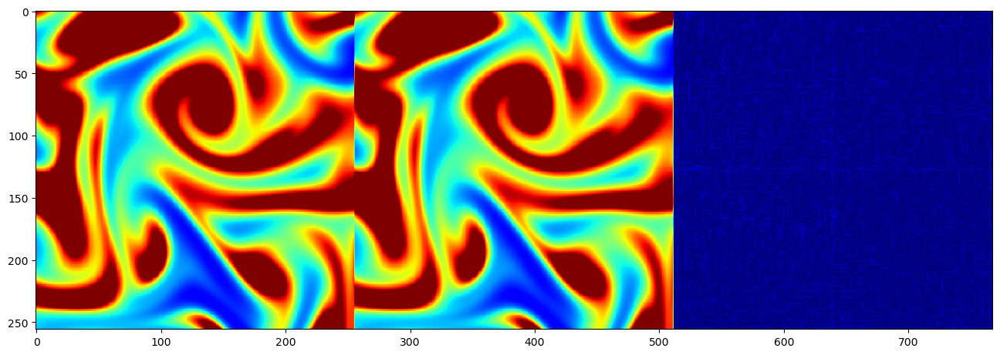

In [50]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import imageio
import numpy as np
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(16,10))

video1 = valid_orgdata[0,0,:,::2,::2]
video2 = valid_rctdata[0,0,:,::2,::2]
residual  = np.abs(video1-video2)*10
video = np.concatenate([video1, video2, residual], axis = -1)
# video = recons_data[:,0]

im = ax.imshow(video[0], cmap="jet")

def update(frame):
    im.set_array(video[frame])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=len(video), interval=1)

# Save as a GIF
ani.save("animation.gif", writer=animation.PillowWriter(fps=5))

# Display in Jupyter Notebook
HTML(ani.to_jshtml())

In [83]:
video2[1]

tensor([[4.8242e-07, 4.7862e-07, 4.8095e-07,  ..., 4.1816e-07, 4.2122e-07,
         4.2467e-07],
        [4.8328e-07, 4.7936e-07, 4.8183e-07,  ..., 4.2025e-07, 4.2189e-07,
         4.2424e-07],
        [4.8280e-07, 4.7982e-07, 4.8184e-07,  ..., 4.2083e-07, 4.2180e-07,
         4.2377e-07],
        ...,
        [3.7607e-07, 3.7165e-07, 3.7090e-07,  ..., 3.8821e-07, 3.8816e-07,
         3.9004e-07],
        [3.7669e-07, 3.7197e-07, 3.7159e-07,  ..., 3.8955e-07, 3.8906e-07,
         3.9023e-07],
        [3.7274e-07, 3.7142e-07, 3.7116e-07,  ..., 3.9020e-07, 3.8986e-07,
         3.9197e-07]])